<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

In [2]:
import skimage, PIL, numpy

In [48]:
PIL.__version__


'5.4.1'

In [26]:
import numpy as np
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, viewer, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc
import utm
import geopandas as gpd
import pandas as pd

# calcul matriciel
import numpy as np
#statistics
import scipy
from scipy import stats
#plot graphique
import matplotlib.pyplot as plt
import seaborn as sns
import osgeo
from skimage.exposure import rescale_intensity
from skimage.segmentation import slic
from skimage.util import img_as_float
from skimage import io
from skimage.segmentation import mark_boundaries
import argparse

In [6]:
from osgeo import gdal
ds = gdal.Open('testP/odm_ortho.tif')

# unravel GDAL affine transform parameters
c, a, b, f, d, e = ds.GetGeoTransform()

def pixel2coord(col, row):
    """Returns global coordinates to pixel center using base-0 raster index"""
    xp = a * col + b * row + a * 0.5 + b * 0.5 + c
    yp = d * col + e * row + d * 0.5 + e * 0.5 + f
    return(xp, yp)

In [32]:
colnames = ['X','Y','Z','R','G','B']
t2 = pd.read_csv('test.txt',sep=' ',names=colnames,header=None)

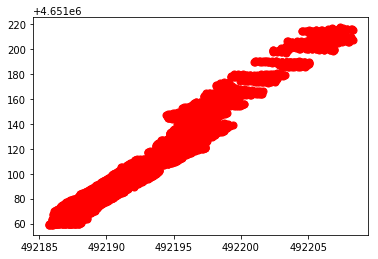

In [42]:
l = 5000
#plt.imshow(imortho_RGB)
plt.scatter(t2['X'].values[0:l], t2['Y'].values[:l], c='r', s=50)

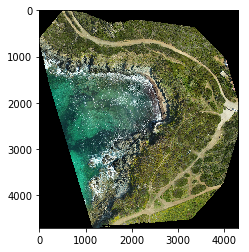

In [40]:
plt.imshow(imortho_RGB)

In [8]:
imdsm = Image.open('testP/dsm.tif')
imortho = Image.open('testP/odm_ortho.tif')
im_ortho_g = imortho.convert('L') 
imortho_RGB = imortho.convert('RGB')

#nbarray
imortho_hsv = color.rgb2hsv(imortho_RGB) # from RGB to HSV color space

/Users/karinepetrus/anaconda3/envs/django_env/lib/python3.7/site-packages/skimage/color/colorconv.py:265: RuntimeWarning: divide by zero encountered in true_divide
  out_s = delta / out_v
/Users/karinepetrus/anaconda3/envs/django_env/lib/python3.7/site-packages/skimage/color/colorconv.py:271: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = (arr[idx, 1] - arr[idx, 2]) / delta[idx]
/Users/karinepetrus/anaconda3/envs/django_env/lib/python3.7/site-packages/skimage/color/colorconv.py:275: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 2. + (arr[idx, 2] - arr[idx, 0]) / delta[idx]
/Users/karinepetrus/anaconda3/envs/django_env/lib/python3.7/site-packages/skimage/color/colorconv.py:279: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 4. + (arr[idx, 0] - arr[idx, 1]) / delta[idx]


In [28]:
%tb
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True,help="path to input image")
ap.add_argument("-s", "--segments", type=int, default=100,help="# of superpixels")
args = vars(ap.parse_args())

SystemExit: 2

usage: ipykernel_launcher.py [-h] -i IMAGE [-s SEGMENTS]
ipykernel_launcher.py: error: the following arguments are required: -i/--image


SystemExit: 2

In [20]:
segments = slic(img_as_float(imortho_hsv),n_segments=200000)#, n_segments=args["segments"],slic_zero=True)

In [ ]:
# load the image in OpenCV format so we can draw on it later, then
# allocate memory for the superpixel colorfulness visualization
orig = cv2.imread(args["image"])
vis = np.zeros(orig.shape[:2], dtype="float")
 
# load the image and apply SLIC superpixel segmentation to it via
# scikit-image
image = io.imread(args["image"])
segments = slic(img_as_float(image), n_segments=args["segments"],slic_zero=True)

In [ ]:
3
54
55
56
57
58
59
60
61
62
# loop over each of the unique superpixels
for v in np.unique(segments):
	# construct a mask for the segment so we can compute image
	# statistics for *only* the masked region
	mask = np.ones(image.shape[:2])
	mask[segments == v] = 0
 
	# compute the superpixel colorfulness, then update the
	# visualization array
	C = segment_colorfulness(orig, mask)
	vis[segments == v] = C

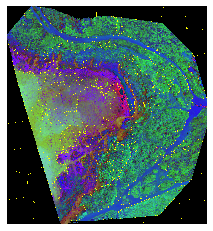

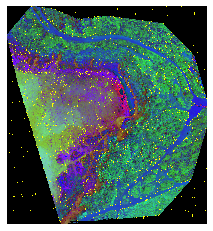

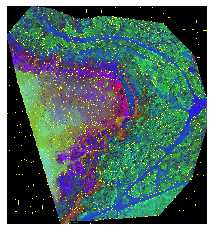

In [24]:
# loop over the number of segments
for numSegments in (100, 200, 300):
# apply SLIC and extract (approximately) the supplied number
	# of segments
    segments = slic(img_as_float(imortho_hsv), n_segments = numSegments, sigma = 5)
 
	# show the output of SLIC
    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(mark_boundaries(imortho_hsv, segments))
    plt.axis("off")
 
# show the plots
plt.show()

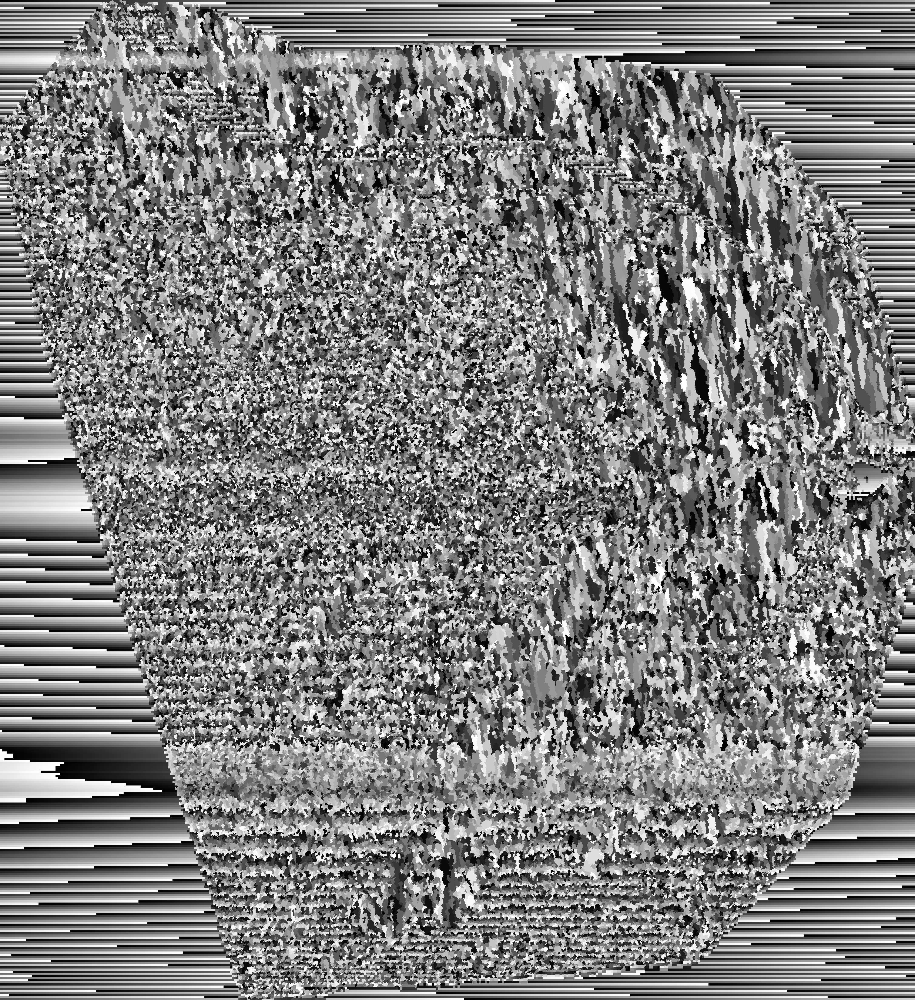

In [21]:
Image.fromarray(np.uint8((segments)))

In [7]:
np.array(imortho).shape

(4699, 4302, 4)

In [30]:
np.array(imortho)[:1,:1]

array([[[0, 0, 0, 0]]], dtype=uint8)

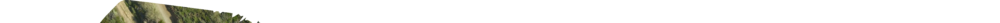

In [26]:
Image.fromarray(np.uint8((np.array(imortho)[:100,:])))

In [17]:
import pandas as pd
pd.DataFrame(np.array(imdsm)).describe()

,0,1,2,3,4,5,6,7,8,9,...,958,959,960,961,962,963,964,965,966,967
count,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,...,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000,1057.000000
mean,-9857.792969,-9791.893555,-9735.410156,-9678.925781,-9631.855469,-9584.783203,-9528.296875,-9481.225586,-9434.155273,-9377.668945,...,-8093.127930,-8159.179688,-8215.795898,-8291.276367,-8347.885742,-8423.363281,-8479.970703,-8546.009766,-8612.050781,-8696.968750
std,1177.484131,1421.199097,1598.655396,1756.512573,1876.682861,1988.426514,2113.429443,2211.087402,2303.586426,2408.760986,...,3922.882568,3870.077637,3823.262695,3758.690186,3708.480225,3639.100342,3585.162598,3520.075684,3452.466553,3361.619141
min,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,...,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000
25%,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,...,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000
50%,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,...,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000
75%,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,...,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000,-9999.000000
max,-48.299999,-48.060001,-47.919998,-47.709999,-47.610001,-47.450001,-47.430000,-47.279999,-47.180000,-46.971569,...,-23.790001,-24.430000,-25.139999,-25.360001,-25.500000,-25.530001,-25.570000,-25.320000,-25.230000,-25.209999


(array([15798924.,  9878402.,  7486319.,  6988432.,  8908158.,  5295999.,
         2986169.,  2159965.,   892906.,   250020.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

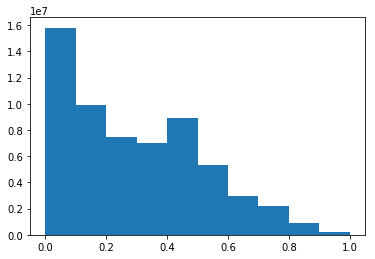

In [30]:
plt.hist(np.array(imortho_hsv).ravel())

In [25]:
d = pd.Series(np.array(imdsm).ravel())

In [26]:
d.head()

0   -9999.0
1   -9999.0
2   -9999.0
3   -9999.0
4   -9999.0
dtype: float32

(array([1.41298e+05, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00]),
 array([1.00000e+00, 2.47520e+04, 4.95030e+04, 7.42540e+04, 9.90050e+04,
        1.23756e+05, 1.48507e+05, 1.73258e+05, 1.98009e+05, 2.22760e+05,
        2.47511e+05]),
 <a list of 10 Patch objects>)

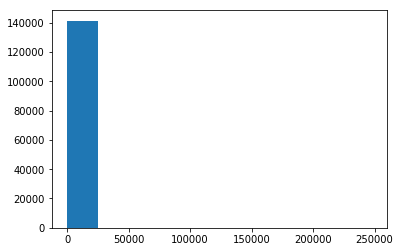

In [28]:
plt.hist(d.value_counts())


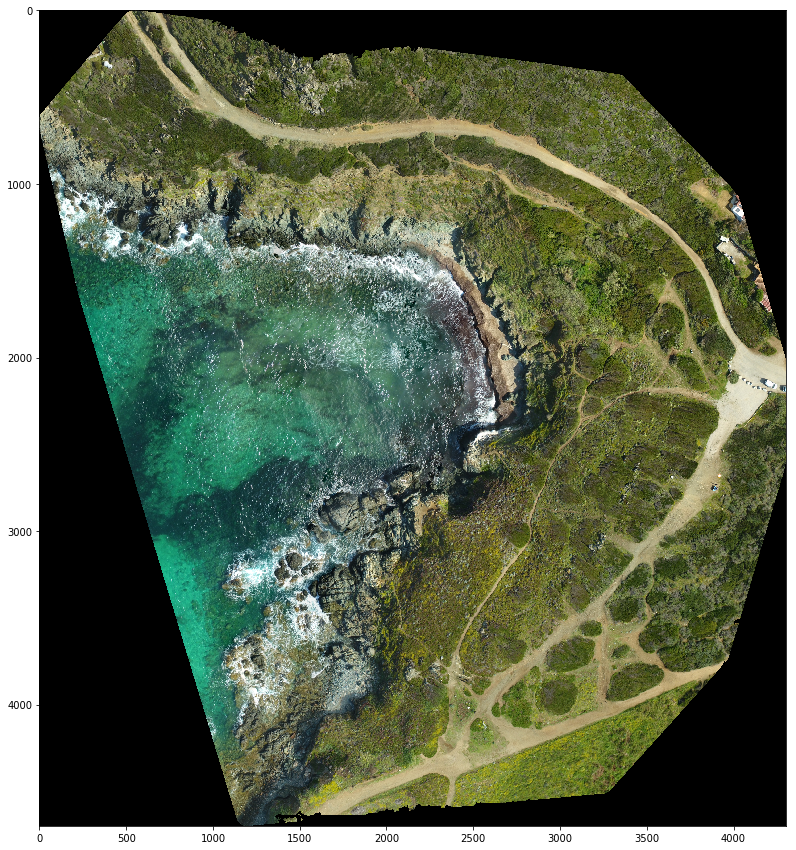

In [8]:
plt.figure(figsize=(15,15))
plt.imshow(imortho_RGB)

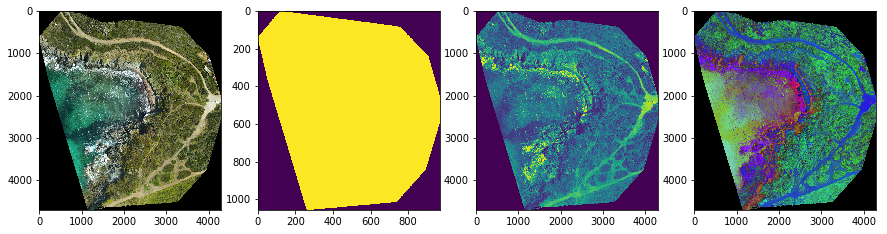

In [4]:
plt.figure(figsize=(15,15))
plt.subplot(141)
plt.imshow(imortho_RGB)
plt.subplot(142)
plt.imshow(imdsm)
plt.subplot(143)
plt.imshow(im_ortho_g)
plt.subplot(144)
plt.imshow(imortho_hsv)
#plt.colorbar()

In [59]:
import pylab
def plot_image(image, title=''):
    pylab.title(title, size=20), pylab.imshow(image)
    pylab.axis('off') # comment this line if you want axis ticks

def plot_hist(r, g, b, title=''):
    r, g, b = img_as_ubyte(r), img_as_ubyte(g), img_as_ubyte(b)
    pylab.hist(np.array(r).ravel(), bins=256, range=(0, 256), color='r', alpha=0.5)
    pylab.hist(np.array(g).ravel(), bins=256, range=(0, 256), color='g', alpha=0.5)
    pylab.hist(np.array(b).ravel(), bins=256, range=(0, 256), color='b', alpha=0.5)
    pylab.xlabel('pixel value', size=20), pylab.ylabel('frequency', size=20)
    pylab.title(title, size=20)


<Figure size 432x288 with 0 Axes>

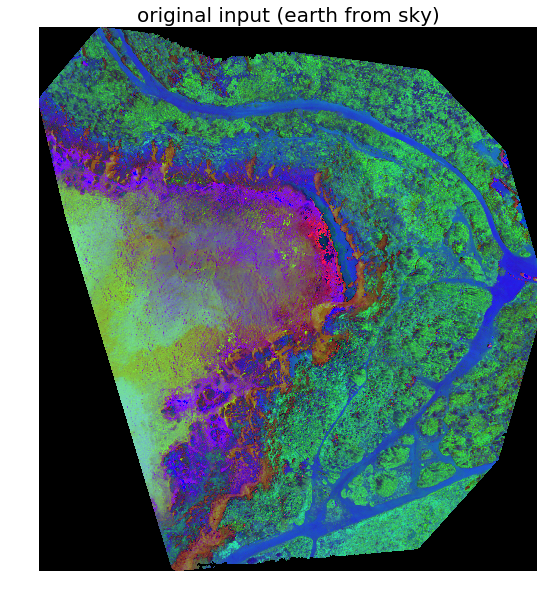

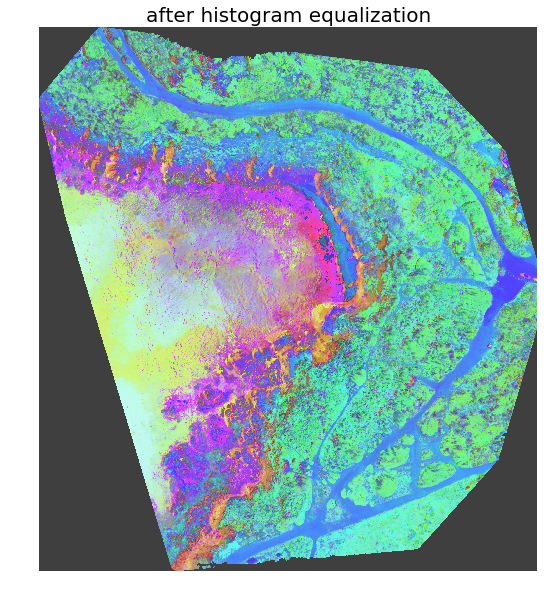

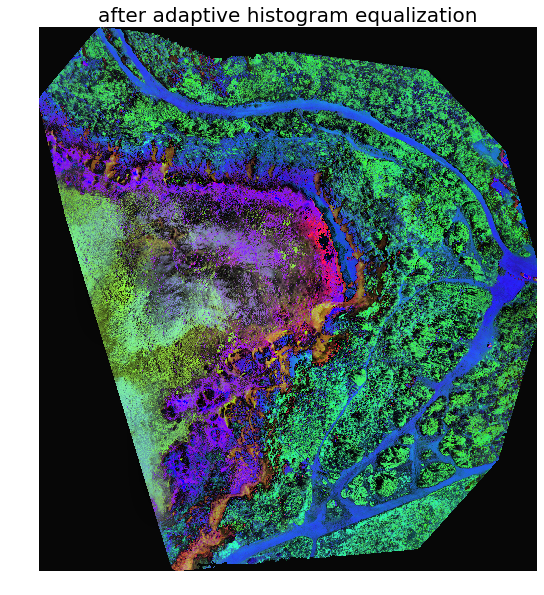

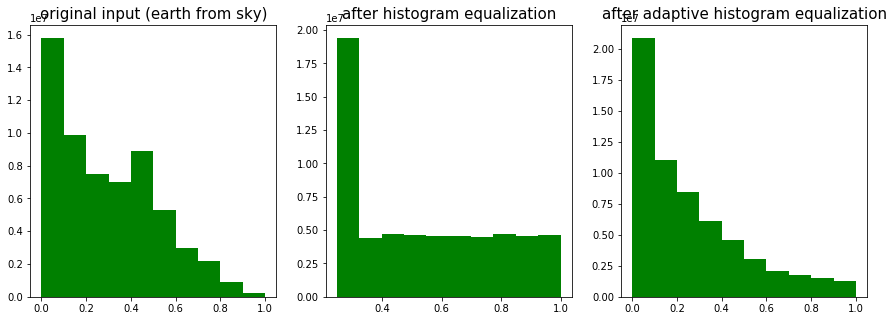

In [8]:
import pylab
# histogram equalization
img_eq = exposure.equalize_hist(imortho_hsv)
# adaptive histogram equalization
img_adapteq = exposure.equalize_adapthist(imortho_hsv, clip_limit=0.03)
pylab.gray()
images = [imortho_hsv, img_eq, img_adapteq]
titles = ['original input (earth from sky)', 'after histogram equalization', 'after adaptive histogram equalization']
for i in range(3):
    pylab.figure(figsize=(10,10)), plot_image(images[i], titles[i])
pylab.figure(figsize=(15,5))
for i in range(3):
    pylab.subplot(1,3,i+1), pylab.hist(images[i].ravel(), color='g'), pylab.title(titles[i], size=15)
pylab.show()

/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/exposure/exposure.py:63: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel.
  warn("This might be a color image. The histogram will be "
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:269: RuntimeWarning: divide by zero encountered in true_divide
  out_s = delta / out_v
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:275: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = (arr[idx, 1] - arr[idx, 2]) / delta[idx]
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:279: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 2. + (arr[idx, 2] - arr[idx, 0]) / delta[idx]
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:283: RuntimeWarning:

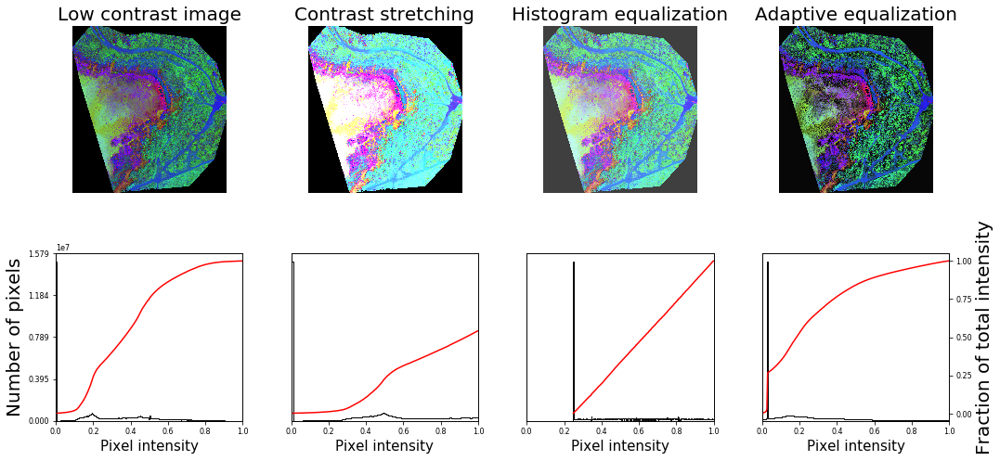

In [47]:
import matplotlib
matplotlib.rcParams['font.size'] = 8
def plot_image_and_hist(image, axes, bins=256):
    image = img_as_float(image)
    axes_image, axes_hist = axes
    axes_cdf = axes_hist.twinx()
    axes_image.imshow(image, cmap=pylab.cm.gray)
    axes_image.set_axis_off()
    axes_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    axes_hist.set_xlim(0, 1)
    axes_hist.set_xlabel('Pixel intensity', size=15)
    axes_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    axes_hist.set_yticks([])
    image_cdf, bins = exposure.cumulative_distribution(image, bins)
    axes_cdf.plot(bins, image_cdf, 'r')
    axes_cdf.set_yticks([])
    return axes_image, axes_hist, axes_cdf

im = imortho_hsv
# contrast stretching
im_rescale = exposure.rescale_intensity(im, in_range=(0, 100), out_range=(0, 255))
im_eq = exposure.equalize_hist(im) # histogram equalization
im_adapteq = exposure.equalize_adapthist(im, clip_limit=0.03) # adaptive histogram equalization

fig = pylab.figure(figsize=(15, 7))
axes = np.zeros((2, 4), dtype = np.object)
axes[0, 0] = fig.add_subplot(2, 4, 1)
for i in range(1, 4):
    axes[0, i] = fig.add_subplot(2, 4, 1+i, sharex=axes[0,0], sharey=axes[0,0])
for i in range(0, 4):
    axes[1, i] = fig.add_subplot(2, 4, 5+i)
axes_image, axes_hist, axes_cdf = plot_image_and_hist(im, axes[:, 0])
axes_image.set_title('Low contrast image', size=20)
y_min, y_max = axes_hist.get_ylim()
axes_hist.set_ylabel('Number of pixels', size=20)
axes_hist.set_yticks(np.linspace(0, y_max, 5))
axes_image, axes_hist, axes_cdf = plot_image_and_hist(im_rescale, axes[:,1])
axes_image.set_title('Contrast stretching', size=20)
axes_image, axes_hist, axes_cdf = plot_image_and_hist(im_eq, axes[:, 2])
axes_image.set_title('Histogram equalization', size=20)
axes_image, axes_hist, axes_cdf = plot_image_and_hist(im_adapteq, axes[:,3])
axes_image.set_title('Adaptive equalization', size=20)
axes_cdf.set_ylabel('Fraction of total intensity', size=20)
axes_cdf.set_yticks(np.linspace(0, 1, 5))
fig.tight_layout()
pylab.show()
 

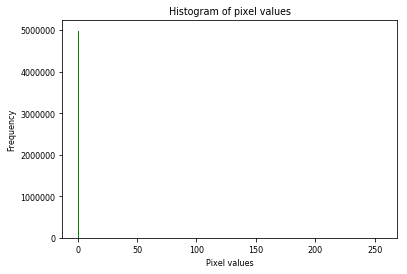

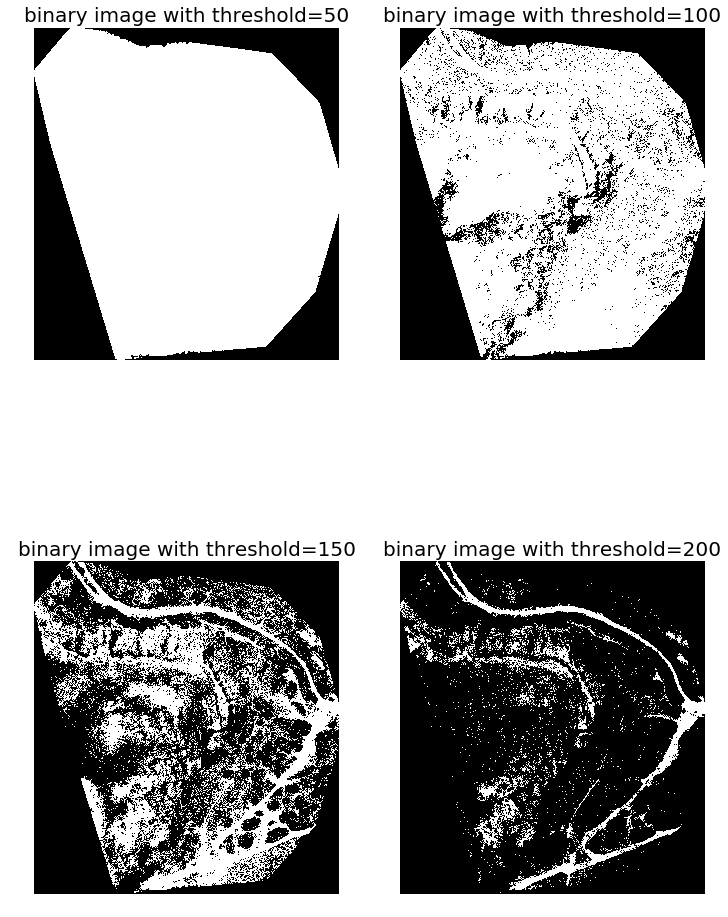

In [61]:
im = im_ortho_g
#img_eq = exposure.equalize_hist(im)
blur_box_kernel = np.ones((30,30)) / 9

im_blurred = signal.convolve2d(im, blur_box_kernel)
pylab.hist(np.array(im_blurred).ravel(), bins=256, range=(0, 256), color='g')
pylab.xlabel('Pixel values'), pylab.ylabel('Frequency'),
pylab.title('Histogram of pixel values')
pylab.show()
pylab.figure(figsize=(12,18))
pylab.gray()
pylab.subplot(221), plot_image(im, 'original image'), pylab.axis('off')
th = [0, 50, 100, 150, 200]
for i in range(1, 5):
    im1 = im.point(lambda x: x > th[i-1])
    pylab.subplot(2,2,i), plot_image(im1, 'binary image with threshold=' + str(th[i]))
pylab.show()

(<matplotlib.axes._subplots.AxesSubplot at 0x1c419cc080>,
 Text(0.5, 1.0, 'v'),
 (-0.5, 4301.5, 4698.5, -0.5))

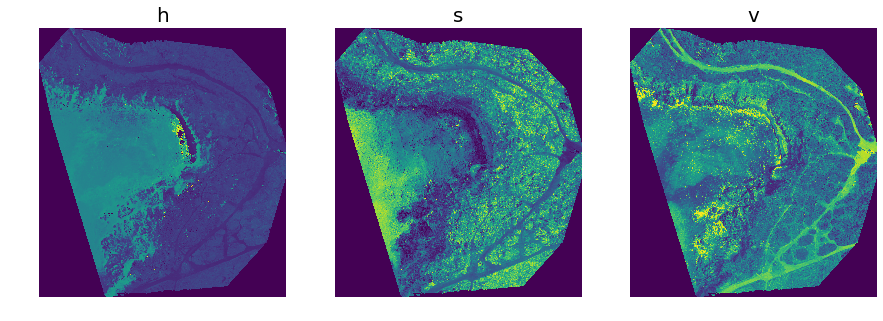

In [34]:
plt.figure(figsize=(15,15))
plt.subplot(131), plt.imshow(imortho_hsv[...,0]), plt.title('h', size=20), plt.axis('off')
plt.subplot(132), plt.imshow(imortho_hsv[...,1]), plt.title('s', size=20), plt.axis('off')
plt.subplot(133), plt.imshow(imortho_hsv[...,2]), plt.title('v', size=20), plt.axis('off')


In [17]:
print(imdsm.width, imdsm.height, imdsm.mode, imdsm.format, type(imdsm))

968 1057 F TIFF <class 'PIL.TiffImagePlugin.TiffImageFile'>


In [18]:
print(imortho.width, imortho.height, imortho.mode, imortho.format, type(imortho))

4302 4699 RGBA TIFF <class 'PIL.TiffImagePlugin.TiffImageFile'>


In [22]:
print(im_ortho_g.width, im_ortho_g.height, im_ortho_g.mode, im_ortho_g.format, type(im_ortho_g))

4302 4699 L None <class 'PIL.Image.Image'>


# Image HSV

In [24]:
imortho_RGB = imortho.convert('RGB')

    Hue-Saturation-Value:
        Each pixel is represented by three-tuple (h, s, v) values, representing hue (color), saturation (colorfulness—how much the color is mixed with white), and value (brightness—how much the color is mixed with black) channel color values for every pixel. The HSV model describes colors in a similar manner to how the human eye tends to perceive colors. 
        hue : dominant wave length of reflected light

In [29]:
viewer = viewer.ImageViewer(imortho_hsv)
viewer.show()

[]

# Image blending

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

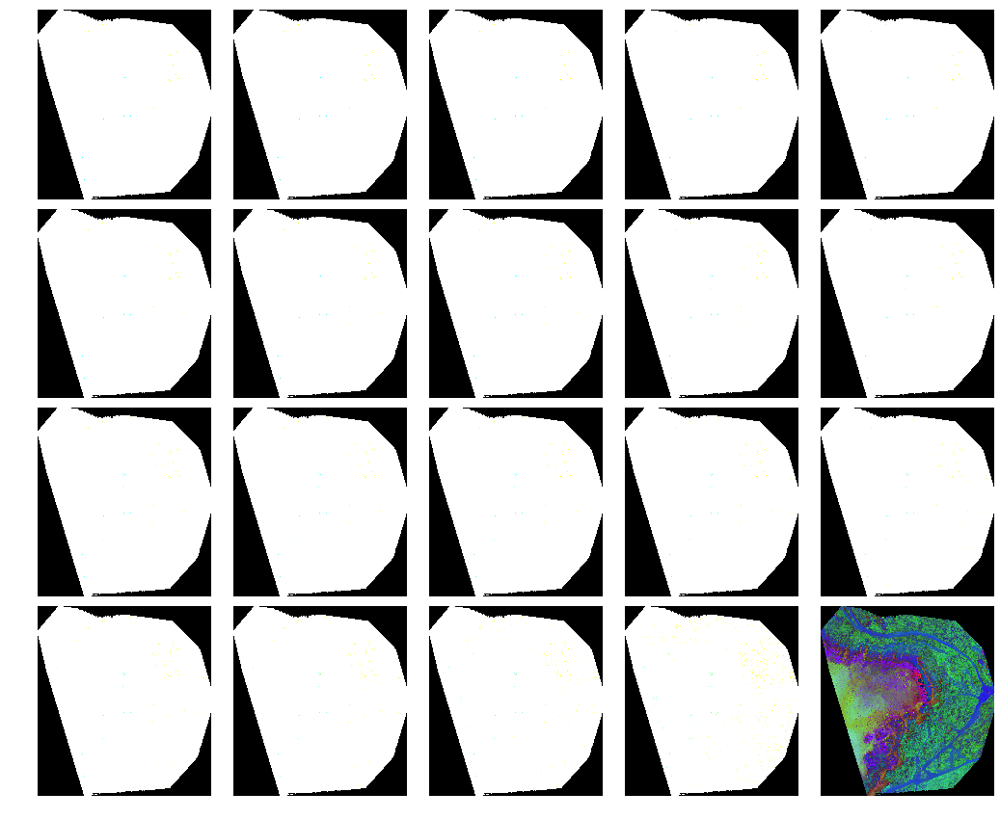

In [41]:

i = 1
plt.figure(figsize=(18,15))
for alpha in np.linspace(0,1,20):
 plt.subplot(4,5,i)
     plt.imshow((1-alpha)*imortho_RGB/255. + alpha*imortho_hsv)
 plt.axis('off')
 i += 1
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()

In [38]:
#Resize
im_small = imortho_hsv.resize((imortho_hsv.width//5, imortho_hsv.height//5), Image.ANTIALIAS)

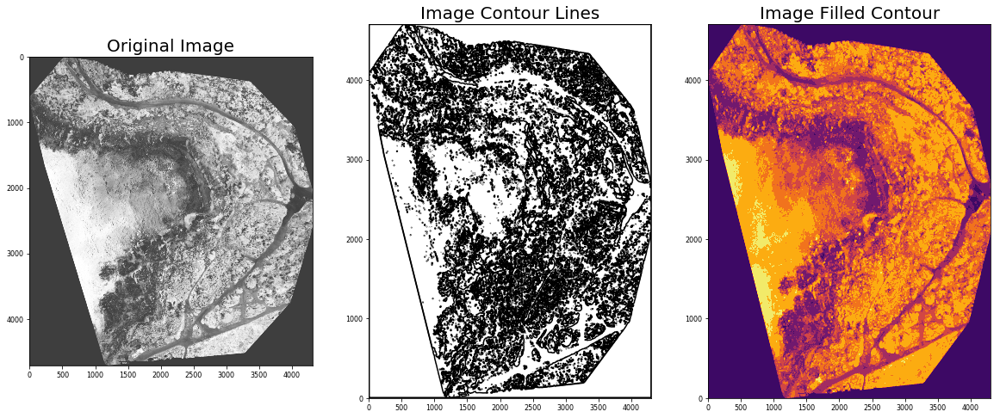

In [56]:
from scipy import ndimage, misc, signal
plt.figure(figsize=(20,8))
imortho = color.rgb2gray(imortho_hsv)
# histogram equalization
img_eq = exposure.equalize_hist(imortho)
blur_box_kernel = np.ones((8,8)) / 9

im_blurred = signal.convolve2d(img_eq, blur_box_kernel)

plt.subplot(131), plt.imshow(im_blurred , cmap='gray'), plt.title('Original Image', size=20) 
plt.subplot(132), plt.contour(np.flipud(im_blurred), colors='k', levels=np.logspace(-15, 15, 100))
plt.title('Image Contour Lines', size=20)
plt.subplot(133), plt.title('Image Filled Contour', size=20), plt.contourf(np.flipud(im_blurred), cmap='inferno')
plt.show()

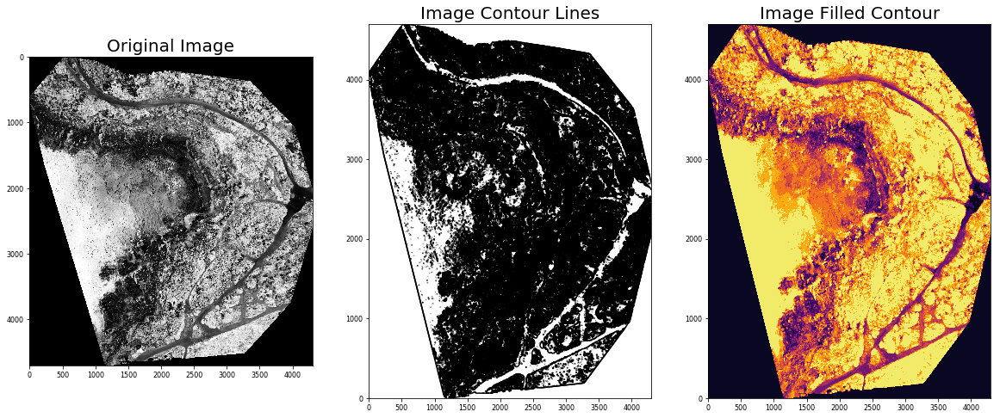

In [49]:
plt.figure(figsize=(20,8))
imortho = color.rgb2gray(imortho_hsv)
# histogram equalization
img_eq = exposure.equalize_hist(imortho)

plt.subplot(131), plt.imshow(img_eq , cmap='gray'), plt.title('Original Image', size=20) 
plt.subplot(132), plt.contour(np.flipud(img_eq), colors='k', levels=np.logspace(-15, 15, 100))
plt.title('Image Contour Lines', size=20)
plt.subplot(133), plt.title('Image Filled Contour', size=20), plt.contourf(np.flipud(img_eq), cmap='inferno')
plt.show()

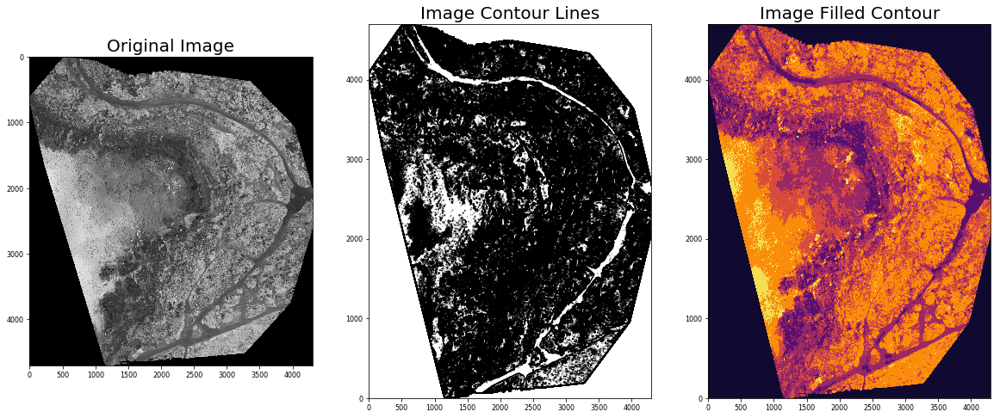

In [50]:
plt.figure(figsize=(20,8))
imortho = color.rgb2gray(imortho_hsv)
# histogram equalization
img_eq = imortho

plt.subplot(131), plt.imshow(img_eq , cmap='gray'), plt.title('Original Image', size=20) 
plt.subplot(132), plt.contour(np.flipud(img_eq), colors='k', levels=np.logspace(-15, 15, 100))
plt.title('Image Contour Lines', size=20)
plt.subplot(133), plt.title('Image Filled Contour', size=20), plt.contourf(np.flipud(img_eq), cmap='inferno')
plt.show()

# Sampling, resize the images

# Convolution 

In [55]:
from PIL import Image
from skimage.io import imread, imshow, show
import scipy.fftpack as fp
from scipy import ndimage, misc, signal
#from scipy.stats import signaltonoise
from skimage import data, img_as_float
from skimage.color import rgb2gray
from skimage.transform import rescale
import matplotlib.pylab as pylab
import numpy as np
import numpy.fft
import timeit

255


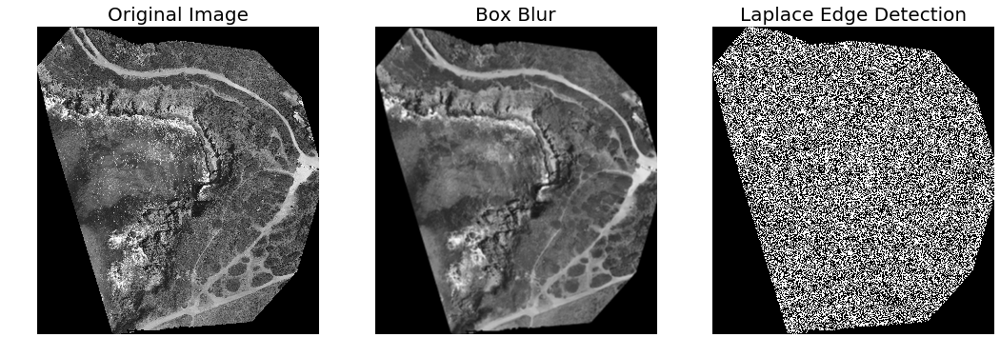

In [57]:
im = im_ortho_g
print(np.max(im))
# 1.0
#print(im.shape)
# (225, 225)
blur_box_kernel = np.ones((30,30)) / 9
edge_laplace_kernel = np.array([[0,1,0],[1,-4,1],[0,1,0]])
im_blurred = signal.convolve2d(im, blur_box_kernel)
im_edges = np.clip(signal.convolve2d(im, edge_laplace_kernel), 0, 1)
fig, axes = pylab.subplots(ncols=3, sharex=True, sharey=True, figsize=(18, 6))
axes[0].imshow(im, cmap=pylab.cm.gray)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_blurred, cmap=pylab.cm.gray)
axes[1].set_title('Box Blur', size=20)
axes[2].imshow(im_edges, cmap=pylab.cm.gray)
axes[2].set_title('Laplace Edge Detection', size=20)
for ax in axes:
 ax.axis('off')
pylab.show()


In [61]:
im.size

(4302, 4699)

In [63]:
im = im_ortho_g
print(np.max(im))

emboss_kernel = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
edge_schar_kernel = np.array([[ -3-3j, 0-10j, +3 -3j], [-10+0j, 0+ 0j, +10+0j], [ -3+3j, 0+10j, +3 +3j]])
im_embossed = np.ones(im.size)
im_edges = np.ones(im.size)
for i in range(3):
    im_embossed[:,:,i] = np.clip(signal.convolve2d(im[...,i], emboss_kernel, mode='same', boundary="symm"),0,1)
for i in range(3):
    im_edges[:,:,i] = np.clip(np.real(signal.convolve2d(im[...,i], edge_schar_kernel, mode='same', boundary="symm")),0,1)
fig, axes = pylab.subplots(nrows=3, figsize=(20, 30))
axes[0].imshow(im)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_embossed)
axes[1].set_title('Embossed Image', size=20)
axes[2].imshow(im_edges)
axes[2].set_title('Schar Edge Detection', size=20)
for ax in axes:
    ax.axis('off')
pylab.show()

255


TypeError: 'Image' object is not subscriptable

255


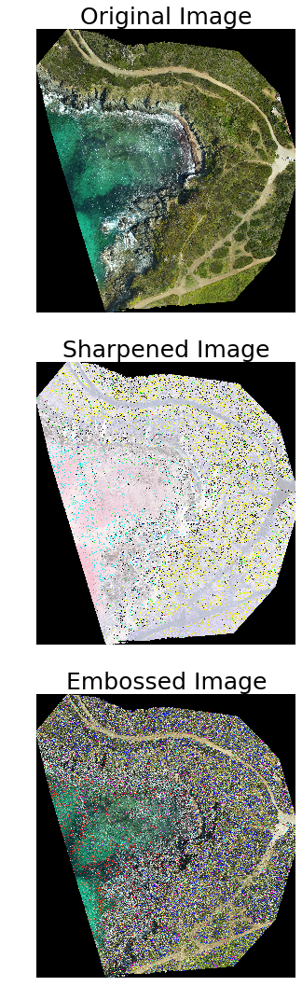

In [151]:

im = imortho_RGB
print(np.max(im))
sharpen_kernel = np.array([1/6., 1/6., -1., 1.@, -1, 1., -1., 1/6., 1/6.]).reshape((3, 3, 1))
emboss_kernel = np.array(np.array([[-2,-1,0],[-1,1,1],[0,1,2]])).reshape((3, 3, 1))
im_sharp = ndimage.convolve(im, sharpen_kernel, mode='nearest')
#im_sharp = np.clip(im_sharp, 0, 255).astype(np.uint8) # clip (0 to 255) and convert to unsigned int
im_emboss = ndimage.convolve(im, emboss_kernel, mode='nearest')
im_emboss = np.clip(im_emboss, 0, 255).astype(np.uint8)
pylab.figure(figsize=(15,15))
pylab.subplot(311), pylab.imshow(im), pylab.axis('off')
pylab.title('Original Image', size=25)
pylab.subplot(312), pylab.imshow(im_sharp), pylab.axis('off')
pylab.title('Sharpened Image', size=25)
pylab.subplot(313), pylab.imshow(im_emboss), pylab.axis('off')
pylab.title('Embossed Image', size=25)
pylab.tight_layout()
pylab.show()

In [123]:
imsave('im_sharp.png',im_sharp)
im_sharp_ = imread("im_sharp.png")

In [17]:
im = Image.fromarray(np.uint8(im_sharp_))
imortho= Image.fromarray(imortho)
im.size
#plt.imshow(im)
plt.imshow(im)

NameError: name 'im_sharp_' is not defined

In [144]:
from PIL.ImageChops import subtract, multiply, screen, difference, add
imfinal = difference(imortho, im)

AttributeError: 'numpy.ndarray' object has no attribute 'load'

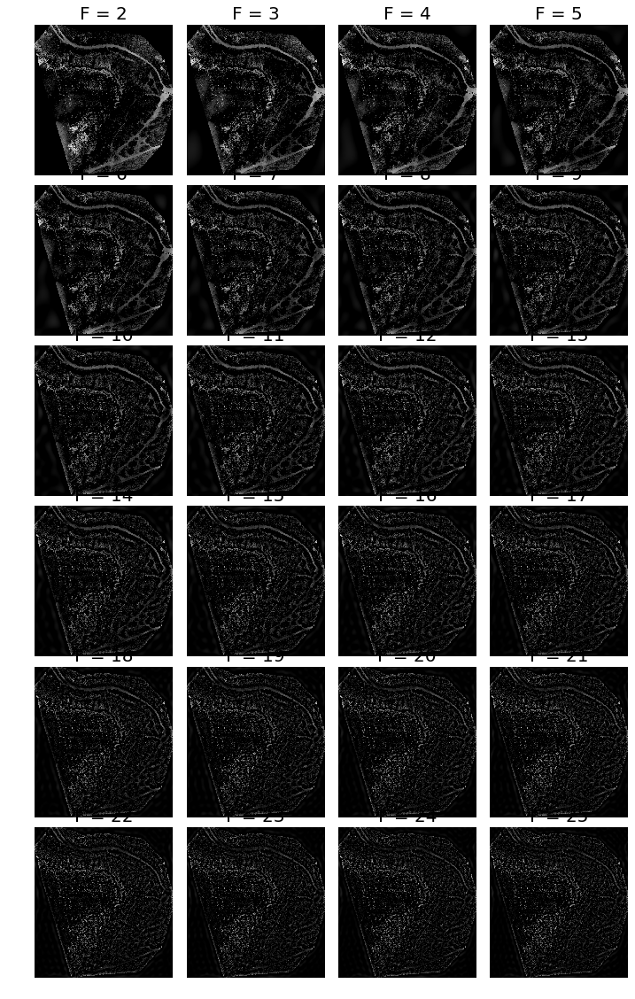

In [74]:
from scipy import fftpack
from scipy import stats
im = im_ortho_g
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
snrs_hp = []
lbs = list(range(1,15))
pylab.figure(figsize=(12,20))
for l in lbs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2[half_w-l:half_w+l+1,half_h-l:half_h+l+1] = 0 # select all but the first lxl (low) frequencies
    im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255) # clip pixel values after IFFT
    pylab.subplot(6,4,l), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('F = ' + str(l+1), size=20)
pylab.subplots_adjust(wspace=0.1, hspace=0)
pylab.show()


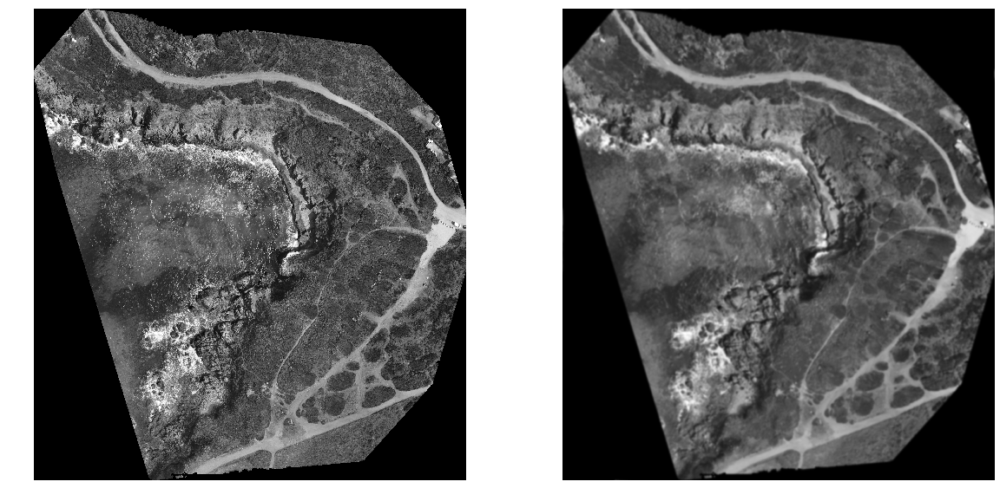

In [87]:
import numpy.fft as fp
fig, (axes1, axes2) = pylab.subplots(1, 2, figsize=(20,10))
pylab.gray() # show the result in grayscale
im = np.mean(imortho_RGB, axis=2)
freq = fp.fft2(im)
freq_gaussian = ndimage.fourier_gaussian(freq, sigma=8)
im1 = fp.ifft2(freq_gaussian)
axes1.imshow(im), axes1.axis('off'), axes2.imshow(im1.real) # the imaginary part is an artifact
axes2.axis('off')
pylab.show()

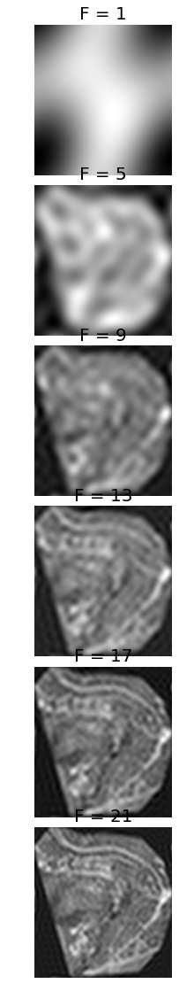

In [92]:

im = im_ortho_g
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
snrs_lp = []
ubs = list(range(1,24,4))
pylab.figure(figsize=(12,20))
for u in ubs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2_low = np.copy(freq2)
    freq2_low[half_w-u:half_w+u+1,half_h-u:half_h+u+1] = 0
    freq2 -= freq2_low # select only the first 20x20 (low) frequencies
    im1 = fp.ifft2(fftpack.ifftshift(freq2)).real
    pylab.subplot(6,4,u), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('F = ' + str(u), size=20)
pylab.subplots_adjust(wspace=0.1, hspace=0)
pylab.show()

In [ ]:
from skimage import img_as_float

pylab.figure(), pylab.imshow(im), pylab.axis('off'), pylab.show()
x = np.linspace(-10, 10, 15)
kernel_1d = np.exp(-0.005*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel1 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
kernel_1d = np.exp(-5*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel2 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
DoGKernel = gauss_kernel1[:, :, np.newaxis] - gauss_kernel2[:, :, np.newaxis]
im = signal.fftconvolve(im, DoGKernel, mode='same')
pylab.figure(), pylab.imshow(np.clip(im, 0, 1)), print(np.max(im)),
pylab.show()

Text(0.5, 1.0, 'Fourier transform')

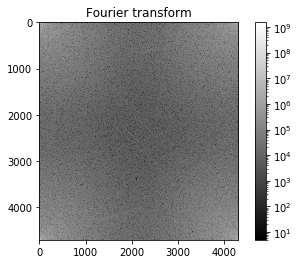

In [101]:
from scipy import fftpack
im_fft = fftpack.fft2(im)

# Show the results

def plot_spectrum(im_fft):
    from matplotlib.colors import LogNorm
    # A logarithmic colormap
    plt.imshow(np.abs(im_fft), norm=LogNorm(vmin=5))
    plt.colorbar()

plt.figure()
plot_spectrum(im_fft)
plt.title('Fourier transform')

In [98]:
im_fft2.shape

(4699, 4302, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(<Figure size 432x288 with 0 Axes>, None, Text(0.5, 1.0, 'Filtered Spectrum'))

<Figure size 432x288 with 0 Axes>

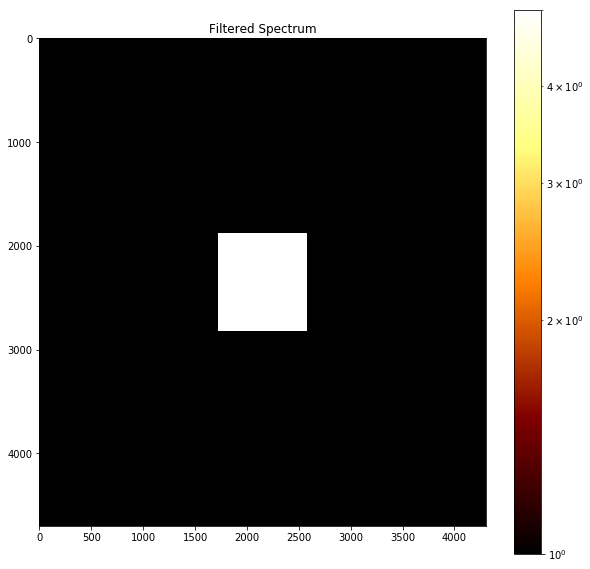

In [99]:
# Copy the original spectrum and truncate coefficients.
# Define the fraction of coefficients (in each direction) to keep as
keep_fraction = 0.1
im_fft2 = im_fft.copy()
# Set r and c to the number of rows and columns of the array.
r, c,rgb = im_fft2.shape
# Set all rows to zero with indices between r*keep_fraction and r*(1-keep_fraction)
im_fft2[int(r*keep_fraction):int(r*(1-keep_fraction))] = 0
# Similarly with the columns
im_fft2[:, int(c*keep_fraction):int(c*(1-keep_fraction))] = 0
pylab.figure(), plot_spectrum(fftpack.fftshift(im_fft2)),pylab.title('Filtered Spectrum')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Reconstructed Image')

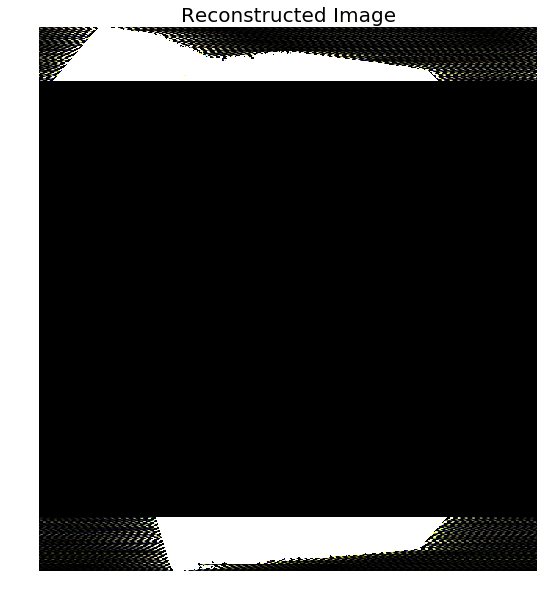

In [100]:
# Reconstruct the denoised image from the filtered spectrum, keep only the real part for display.
im_new = fp.ifft2(im_fft2).real
pylab.figure(figsize=(10,10)), pylab.imshow(im_new, pylab.cm.gray),
pylab.axis('off')
pylab.title('Reconstructed Image', size=20)

In [38]:
from skimage import data, img_as_float
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage.measure import compare_psnr
from skimage.util import random_noise

/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/util/dtype.py:141: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


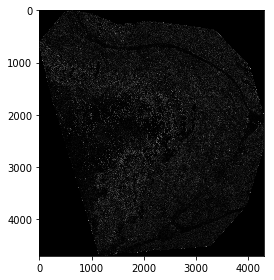

In [102]:
from skimage import io
from skimage import filters
from skimage import color

#img = color.rgb2gray(img)
edge = filters.sobel(im_ortho_g)
io.imshow(edge)
io.imsave("sobel_edge.jpg", edge)
io.show()

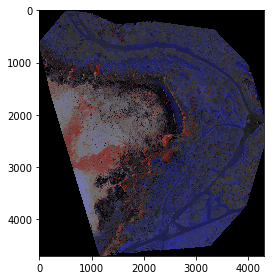

In [104]:
from skimage import morphology
from skimage import io 


eroded_img  = morphology.erosion(imortho_hsv)

io.imshow(eroded_img)
io.show()


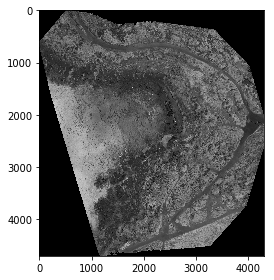

In [105]:
eroded_img  = morphology.erosion(imortho)

io.imshow(eroded_img)
io.show()

In [147]:
imortho_RGB = color.gray2rgb(imortho)
eroded_img  = morphology.erosion(imortho_RGB)

io.imshow(eroded_img)
io.show()

AttributeError: 'TiffImageFile' object has no attribute 'shape'

In [ ]:
eroded_img 

/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:269: RuntimeWarning: divide by zero encountered in true_divide
  out_s = delta / out_v
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:275: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = (arr[idx, 1] - arr[idx, 2]) / delta[idx]
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:279: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 2. + (arr[idx, 2] - arr[idx, 0]) / delta[idx]
/Users/karinepetrus/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:283: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 4. + (arr[idx, 0] - arr[idx, 1]) / delta[idx]


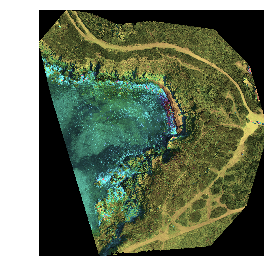

((0.0, 1.0, 0.0, 1.0), <matplotlib.image.AxesImage at 0x1c29bd76d8>, None)

In [30]:
#imortho_RGB

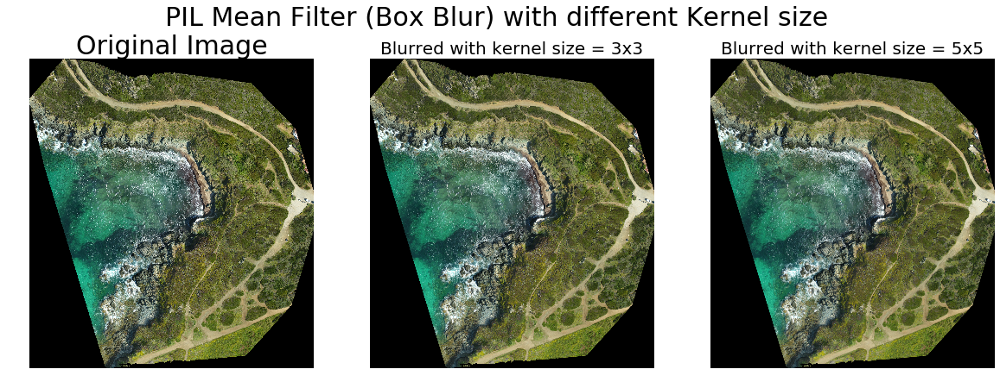

In [45]:
from PIL import Image, ImageEnhance, ImageFilter
im = imortho_RGB
#im = Image(np.int(imortho_hsv))

pylab.figure(figsize=(20,7))
pylab.subplot(1,3,1), pylab.imshow(im), pylab.title('Original Image', size=30), pylab.axis('off')
for n in [3,5]:
    box_blur_kernel = np.reshape(np.ones(n*n),(n,n)) / (n*n)
    im1 = im.filter(ImageFilter.Kernel((n,n), box_blur_kernel.flatten()))
    pylab.subplot(1,3,(2 if n==3 else 3))
    plot_image(im1, 'Blurred with kernel size = ' + str(n) + 'x' + str(n))
pylab.suptitle('PIL Mean Filter (Box Blur) with different Kernel size',
size=30)
pylab.show()

TypeError: 'Image' object is not subscriptable

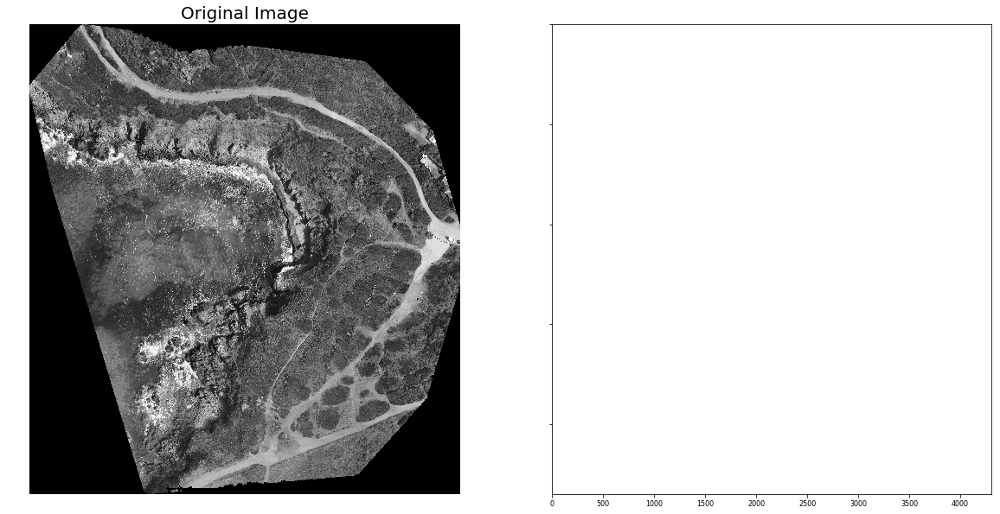

In [51]:
import numpy as np
from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as pylab
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries
img = np.array(im_ortho_g)
fig, axes = pylab.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)
axes = axes.ravel()
axes[0].imshow(image, cmap=pylab.cm.gray), axes[0].set_axis_off()
axes[0].set_title('Original Image', size=20)
hough_radii = np.arange(65, 75, 1)
hough_res = hough_circle(img, hough_radii)
# Select the most prominent 4 circles
accums, c_x, c_y, radii = hough_circle_peaks(hough_res, hough_radii, total_num_peaks=4)
image = color.gray2rgb(image)
for center_y, center_x, radius in zip(c_y, c_x, radii):
 circ_y, circ_x = circle_perimeter(center_y, center_x, radius)
 image[circ_y, circ_x] = (1, 0, 0)
axes[1].imshow(image, cmap=pylab.cm.gray), axes[1].set_axis_off()
axes[1].set_title('Detected Circles', size=20)
pylab.tight_layout(), pylab.show()

In [ ]:
image = img
thresh = threshold_otsu(image)
binary = image > thresh

fig, axes = pylab.subplots(nrows=2, ncols=2, figsize=(20, 15))
axes = axes.ravel()
axes[0], axes[1] = pylab.subplot(2, 2, 1), pylab.subplot(2, 2, 2)
axes[2] = pylab.subplot(2, 2, 3, sharex=axes[0], sharey=axes[0])
axes[3] = pylab.subplot(2, 2, 4, sharex=axes[0], sharey=axes[0])
axes[0].imshow(image, cmap=pylab.cm.gray)
axes[0].set_title('Original', size=20), axes[0].axis('off')
axes[1].hist(image.ravel(), bins=256, normed=True)
axes[1].set_title('Histogram', size=20), axes[1].axvline(thresh, color='r')
axes[2].imshow(binary, cmap=pylab.cm.gray)
axes[2].set_title('Thresholded (Otsu)', size=20), axes[2].axis('off')
axes[3].axis('off'), pylab.tight_layout(), pylab.show()

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
for imfile in ['../images/eagle.png', '../images/horses.png', '../images/flowers.png', '../images/bisons.png']:
 img = img_as_float(imread(imfile)[::2, ::2, :3])
 pylab.figure(figsize=(20,10))
 segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=400)
 borders = find_boundaries(segments_fz)
 unique_colors = np.unique(segments_fz.ravel())
 segments_fz[borders] = -1 
 colors = [np.zeros(3)]
 for color in unique_colors:
   colors.append(np.mean(img[segments_fz == color], axis=0)) 
 cm = LinearSegmentedColormap.from_list('pallete', colors, N=len(colors))
 pylab.subplot(121), pylab.imshow(img), pylab.title('Original', size=20), pylab.axis('off') 
 pylab.subplot(122), pylab.imshow(segments_fz, cmap=cm), 
 pylab.title('Segmented with Felzenszwalbs\'s method', size=20), pylab.axis('off') 
 pylab.show()

<Figure size 432x288 with 0 Axes>

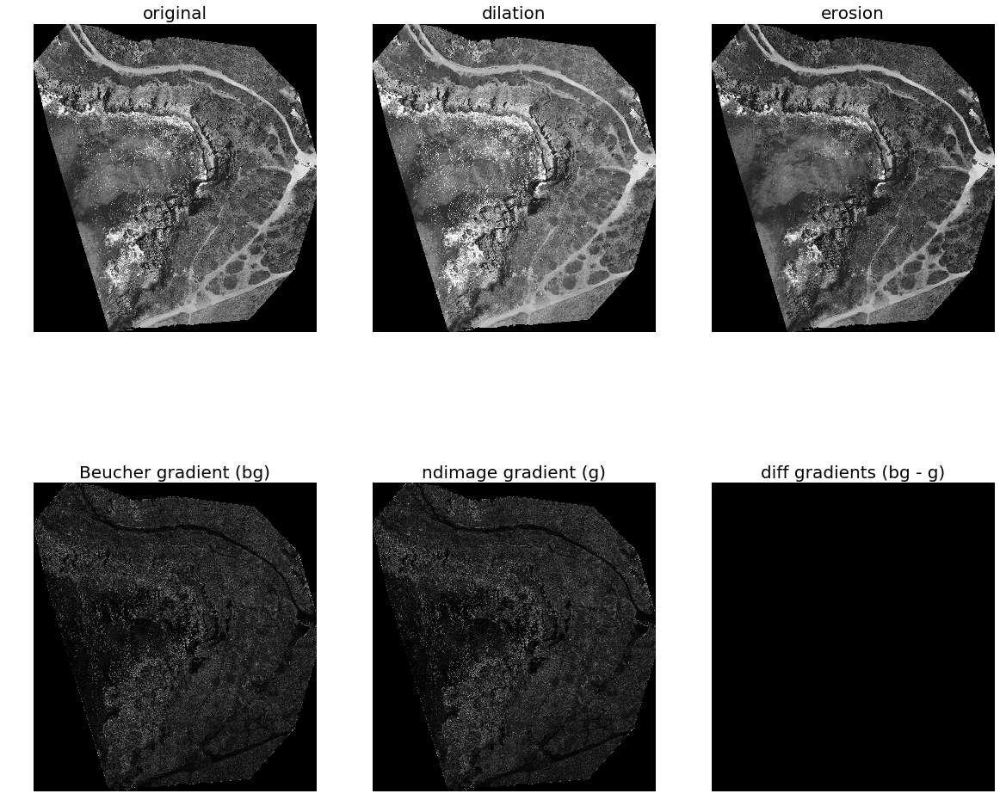

In [38]:
import pylab
from scipy import ndimage
im = im_ortho_g
im_d = ndimage.grey_dilation(im, size=(3,3))
im_e = ndimage.grey_erosion(im, size=(3,3))
im_bg = im_d - im_e
im_g = ndimage.morphological_gradient(im, size=(3,3))
pylab.gray()
pylab.figure(figsize=(20,18))
pylab.subplot(231), pylab.imshow(im), pylab.title('original', size=20),
pylab.axis('off')
pylab.subplot(232), pylab.imshow(im_d), pylab.title('dilation', size=20),
pylab.axis('off')
pylab.subplot(233), pylab.imshow(im_e), pylab.title('erosion', size=20),
pylab.axis('off')
pylab.subplot(234), pylab.imshow(im_bg), pylab.title('Beucher gradient (bg)', size=20), pylab.axis('off')
pylab.subplot(235), pylab.imshow(im_g), pylab.title('ndimage gradient (g)', size=20), pylab.axis('off')
pylab.subplot(236), pylab.title('diff gradients (bg - g)', size=20), pylab.imshow(im_bg - im_g) 
pylab.axis('off')
pylab.show()


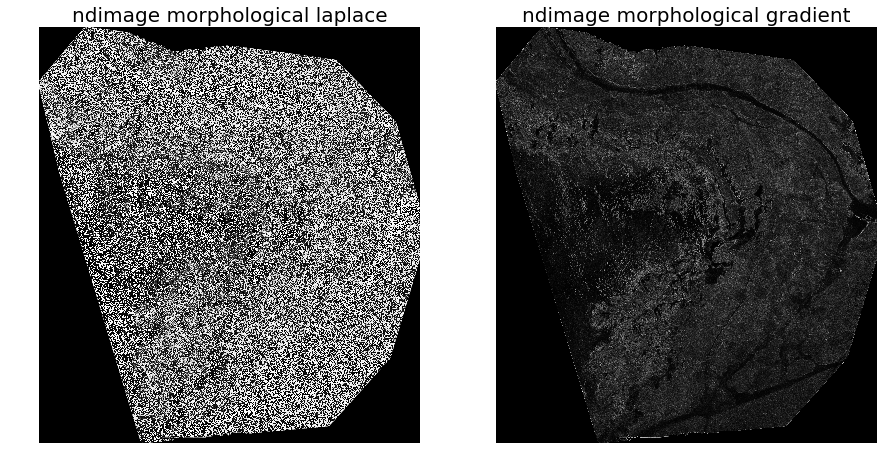

In [39]:
im_g = ndimage.morphological_gradient(im, size=(3,3))
im_l = ndimage.morphological_laplace(im, size=(5,5))
pylab.figure(figsize=(15,10))
pylab.subplot(121), pylab.title('ndimage morphological laplace', size=20), pylab.imshow(im_l)
pylab.axis('off')
pylab.subplot(122), pylab.title('ndimage morphological gradient', size=20),
pylab.imshow(im_g)
pylab.axis('off')
pylab.show()

In [40]:
from matplotlib import pylab as pylab
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.feature import corner_harris, corner_subpix, corner_peaks
from skimage.transform import warp, SimilarityTransform, AffineTransform, resize
import cv2
import numpy as np
from skimage import data
from skimage.util import img_as_float
from skimage.exposure import rescale_intensity
from skimage.measure import ransac

Harris Corner Detector
This algorithm explores the intensity changes within a window as the window changes location inside an image. Unlike an edge, for which intensity values change abruptly in only one direction, there is a significant change in intensity values at a corner in all directions. Hence, a large change in intensity value should result when the window is shifted in any direction at the corner (with good localization); this fact is exploited in the Harris Corner Detector algorithm. It is invariant to rotation, but not to scale (that is, the corner points found from an image remain unchanged when the image undergoes a rotation transformation, but change when the image is resized). In this section, we shall discuss how to implement a Harris Corner Detector with scikit-image.

With scikit-image
The next code snippet shows how to detect corner points in an image using the Harris Corner Detector with the corner_harris() function from the scikit-imagefeature module:

Copy
image = imread('../images/chess_football.png') # RGB image
image_gray = rgb2gray(image)
coordinates = corner_harris(image_gray, k =0.001)
image[coordinates>0.01*coordinates.max()]=[255,0,0,255]
pylab.figure(figsize=(20,10))
pylab.imshow(image), pylab.axis('off'), pylab.show()
The next screenshot shows the output of the code, with the corners detected as red points:


With sub-pixel accuracy
Sometimes, the corners may be needed to be found with maximum accuracy. With the corner_subpix() function from the scikit-image's feature module, the corners detected are refined with sub-pixel accuracy. The following code demonstrates how to use this function. The Louvre Pyramid in Paris is used as the input image. As usual, first the Harris Corners are computed with corner_peaks(), then the sub-pixel positions of corners are computed with the corner_subpix() function, which uses a statistical test to decide whether to accept/reject a corner point computed earlier with the corner_peaks() function. We need to define the size of neighborhood (window) the function will use to search for corners:

Copy
image = imread('../images/pyramids2.jpg')
image_gray = rgb2gray(image)
coordinates = corner_harris(image_gray, k =0.001)
coordinates[coordinates > 0.03*coordinates.max()] = 255 # threshold for an optimal value, depends on the image
corner_coordinates = corner_peaks(coordinates)
coordinates_subpix = corner_subpix(image_gray, corner_coordinates, window_size=11)
pylab.figure(figsize=(20,20))
pylab.subplot(211), pylab.imshow(coordinates, cmap='inferno')
pylab.plot(coordinates_subpix[:, 1], coordinates_subpix[:, 0], 'r.', markersize=5, label='subpixel')
pylab.legend(prop={'size': 20}), pylab.axis('off')
pylab.subplot(212), pylab.imshow(image, interpolation='nearest')
pylab.plot(corner_coordinates[:, 1], corner_coordinates[:, 0], 'bo', markersize=5)
pylab.plot(coordinates_subpix[:, 1], coordinates_subpix[:, 0], 'r+', markersize=10), pylab.axis('off')
pylab.tight_layout(), pylab.show()
The next couple of screenshots show the output of the code. In the first screenshot, the Harris Corners are marked in yellow pixels and the refined sub-pixel corners are marked with red pixels. In the second screenshot, the corners detected are plotted on top of the original input image with blue pixels and the sub-pixel, again with red pixels:
 

An application – image matching
Once we have detected the interest points in an image, it would be good to know how to match the points across different images of the same object. For example, the following list shows the general approach to matching two such images:

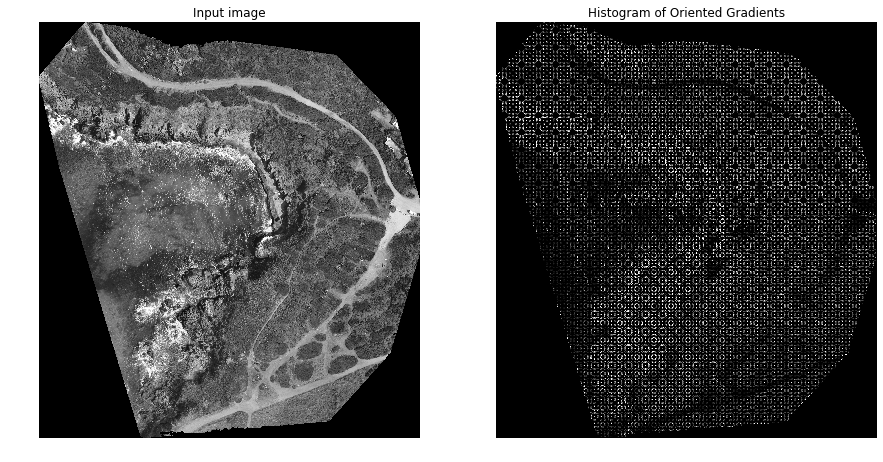

In [46]:
from skimage.feature import hog
from skimage import exposure

fd, hog_image = hog(im, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True) 
#print(im.shape, len(fd))
# ((256L, 256L), 2048)
fig, (axes1, axes2) = pylab.subplots(1, 2, figsize=(15, 10), sharex=True, sharey=True)
axes1.axis('off'), axes1.imshow(im, cmap=pylab.cm.gray), axes1.set_title('Input image')
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
axes2.axis('off'), axes2.imshow(hog_image_rescaled, cmap=pylab.cm.gray), axes2.set_title('Histogram of Oriented Gradients')
pylab.show()

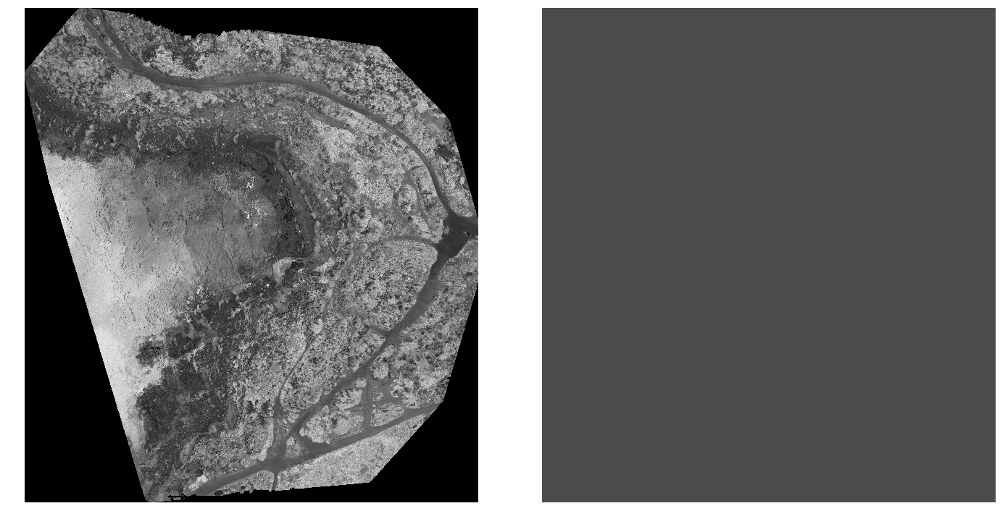

(None, None)

In [65]:
from skimage import segmentation
from skimage.future import graph

def _weight_mean_color(graph, src, dst, n):
 diff = graph.node[dst]['mean color'] - graph.node[n]['mean color']
 diff = np.linalg.norm(diff)
 return {'weight': diff}

def merge_mean_color(graph, src, dst):
 graph.node[dst]['total color'] += graph.node[src]['total color']
 graph.node[dst]['pixel count'] += graph.node[src]['pixel count']
 graph.node[dst]['mean color'] = (graph.node[dst]['total color'] /  graph.node[dst]['pixel count'])

img = imortho
labels = segmentation.slic(img, compactness=30, n_segments=400)
g = graph.rag_mean_color(img, labels)
labels2 = graph.merge_hierarchical(labels, g, thresh=35, rag_copy=False,
in_place_merge=True,
merge_func=merge_mean_color,
weight_func=_weight_mean_color)
out =  color.label2rgb(labels2, img, kind='avg')
out = segmentation.mark_boundaries(out, labels2, (0, 0, 0))
pylab.figure(figsize=(20,10))
pylab.subplot(121), pylab.imshow(img), pylab.axis('off')
pylab.subplot(122), pylab.imshow(out), pylab.axis('off')
pylab.tight_layout(), pylab.show()

In [70]:
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as pylab
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries


In [71]:
img = im_ortho_g#_as_float(imread(im_ortho_g)[::2, ::2, :3])
pylab.figure(figsize=(20,10))
segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=400)
borders = find_boundaries(segments_fz)
unique_colors = np.unique(segments_fz.ravel())
segments_fz[borders] = -1 
colors = [np.zeros(3)]
for color in unique_colors:
    colors.append(np.mean(img[segments_fz == color], axis=0)) 
    cm = LinearSegmentedColormap.from_list('pallete', colors, N=len(colors))
    pylab.subplot(121), pylab.imshow(img), pylab.title('Original', size=20), pylab.axis('off') 
    pylab.subplot(122), pylab.imshow(segments_fz, cmap=cm), 
    pylab.title('Segmented with Felzenszwalbs\'s method', size=20), pylab.axis('off') 
    pylab.show()

TypeError: 'Image' object is not subscriptable

<Figure size 1440x720 with 0 Axes>